<img src="https://github.com/retkowsky/visual-search-azureAI/blob/main/logo.jpg?raw=true">

# Fashion Visual Search demo

## 6. Azure Open AI for visual search

This code demonstrates how to use **Azure Cognitive Search** with **Cognitive Services Florence Vision API** and Azure Python SDK for visual search.


## Steps
- Connect to a blob storage where your catalog images are
- Use Azure Computer Vision 4 to embed all these images
- Create an Azure Cognitive search vector store index
- Upload the embeddings into an Azure Cognitive Search index
- Do some visual search using a prompt or an image


## Visual search with vector embeddings
Vector embeddings are a way of representing content such as text or images as vectors of real numbers in a high-dimensional space. These embeddings are often learned from large amounts of textual and visual data using machine learning algorithms like neural networks. Each dimension of the vector corresponds to a different feature or attribute of the content, such as its semantic meaning, syntactic role, or context in which it commonly appears. By representing content as vectors, we can perform mathematical operations on them to compare their similarity or use them as inputs to machine learning models.

## Process
<img src="https://raw.githubusercontent.com/retkowsky/Azure-Computer-Vision-in-a-day-workshop/72c07afc4fcc04a29ca19b84d3d343a09a22368e//fashionprocess.png" width=512>

## Business applications
- Digital asset management: Image retrieval can be used to manage large collections of digital images, such as in museums, archives, or online galleries. Users can search for images based on visual features and retrieve the images that match their criteria.
- Medical image retrieval: Image retrieval can be used in medical imaging to search for images based on their diagnostic features or disease patterns. This can help doctors or researchers to identify similar cases or track disease progression.
- Security and surveillance: Image retrieval can be used in security and surveillance systems to search for images based on specific features or patterns, such as in, people & object tracking, or threat detection.
- Forensic image retrieval: Image retrieval can be used in forensic investigations to search for images based on their visual content or metadata, such as in cases of cyber-crime.
- E-commerce: Image retrieval can be used in online shopping applications to search for similar products based on their features or descriptions or provide recommendations based on previous purchases.
- Fashion and design: Image retrieval can be used in fashion and design to search for images based on their visual features, such as color, pattern, or texture. This can help designers or retailers to identify similar products or trends.

## To learn more
- https://learn.microsoft.com/en-us/azure/cognitive-services/computer-vision/concept-image-retrieval
- https://learn.microsoft.com/en-us/azure/search/search-what-is-azure-search

In this notebook we took some samples fashion images are taken from this link:<br>
https://www.kaggle.com/datasets/paramaggarwal/fashion-product-images-dataset

> Note: Image retrieval is curently in public preview

## 1. Python librairies

In [1]:
# %pip install azure-cognitiveservices-speech

In [2]:
import azure.cognitiveservices.speech as speechsdk
import datetime
import io
import json
import math
import matplotlib.pyplot as plt
import numpy as np
import openai
import os
import random
import requests
import sys
import time

from azure.core.credentials import AzureKeyCredential
from azure.search.documents import SearchClient
from azure.search.documents.indexes import SearchIndexClient
from azure.search.documents.indexes import SearchIndexerClient
from azure.search.documents.models import Vector
from azure.search.documents.indexes.models import (
    SearchIndexerDataContainer,
    SearchIndexerDataSourceConnection,
)
from azure.storage.blob import BlobServiceClient
from azure.cognitiveservices.speech import (
    AudioDataStream,
    SpeechConfig,
    SpeechSynthesizer,
    SpeechSynthesisOutputFormat,
)
from azure.cognitiveservices.speech.audio import AudioOutputConfig

from dotenv import load_dotenv
from io import BytesIO
from IPython.display import Audio
from PIL import Image
from pydub import AudioSegment

In [3]:
sys.version

'3.8.5 (default, Sep  4 2020, 07:30:14) \n[GCC 7.3.0]'

In [4]:
print("Today is", datetime.datetime.today())

Today is 2023-07-11 15:17:14.422065


## 2. Azure AI Services

In [5]:
load_dotenv("azure.env")

# Azure Computer Vision 4
acv_key = os.getenv("acv_key")
acv_endpoint = os.getenv("acv_endpoint")

# Azure Cognitive Search
acs_endpoint = os.getenv("acs_endpoint")
acs_key = os.getenv("acs_key")

# Azure Open AI
openai.api_type = os.getenv("openai.api_type")
openai.api_base = os.getenv("openai.api_base")
openai.api_version = os.getenv("openai.api_version")
openai.api_key = os.getenv("openai.api_key")

# Azure Speech service
azure_speech_key = os.getenv("asps_key")
azure_speech_region = os.getenv("asps_region")

In [6]:
if acs_endpoint.endswith("/"):
    acs_endpoint = acv_endpoint[:-1]

if not openai.api_base.endswith("/"):
    openai.api_base = openai.api_base + "/"

## 3. Functions & parameters

In [7]:
# Azure Cognitive Search index name to create
index_name = "azure-fashion-demo"

# Azure Cognitive Search api version
api_version = "2023-02-01-preview"

In [8]:
def text_embedding(prompt):
    """
    Text embedding using Azure Computer Vision 4.0
    """
    version = "?api-version=" + api_version + "&modelVersion=latest"
    vec_txt_url = f"{acv_endpoint}/computervision/retrieval:vectorizeText{version}"
    headers = {"Content-type": "application/json", "Ocp-Apim-Subscription-Key": acv_key}
    payload = {"text": prompt}
    response = requests.post(vec_txt_url, json=payload, headers=headers)

    if response.status_code == 200:
        text_emb = response.json().get("vector")

        return text_emb

    else:
        print(f"Error: {response.status_code} - {response.text}")

        return None

In [9]:
def get_cosine_similarity(vector1, vector2):
    """
    Get cosine similarity value between two embedded vectors
    """
    dot_product = sum(x * y for x, y in zip(vector1, vector2))
    magnitude1 = math.sqrt(sum(x * x for x in vector1))
    magnitude2 = math.sqrt(sum(x * x for x in vector2))
    cosine_similarity = dot_product / (magnitude1 * magnitude2)

    return cosine_similarity

In [10]:
def prompt_search(prompt, topn=5, disp=False):
    """
    Azure Cognitive visual search using a prompt
    """
    results_list = []

    # Initialize the Azure Cognitive Search client
    search_client = SearchClient(acs_endpoint, index_name, AzureKeyCredential(acs_key))
    # Perform vector search
    vector = Vector(value=text_embedding(prompt), k=topn, fields="imagevector")
    response = search_client.search(
        search_text=prompt, vector=vector, select=["idfile", "imagefile"]
    )
    print("\033[1;31;34m")
    print("Finding images using prompt =", prompt, "\n")

    for nb, result in enumerate(response, 1):
        image_file = result["imagefile"]
        results_list.append(image_file)
        if disp:
            print(f"Top {nb:02} : {image_file}")

    return results_list

In [11]:
def display_images(images_list, num_cols=5, disp_cosine=False, source="prompt"):
    """
    Display multiple images
    """
    num_images = len(images_list)
    num_rows = (num_images + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 12))

    if disp_cosine and source == "prompt":
        cos_list = [
            get_cosine_similarity(text_embedding(prompt), image_embedding(image))
            for image in images_list
        ]

    if disp_cosine and source == "image":
        cos_list = [
            get_cosine_similarity(
                url_image_embedding(image_url), image_embedding(image)
            )
            for image in images_list
        ]

    for idx, ax in enumerate(axes.flat):
        if idx < num_images:
            blob_client = container_client.get_blob_client(images_list[idx])
            blob_image = blob_client.download_blob().readall()
            ax.axis("off")
            # Display image
            image = Image.open(io.BytesIO(blob_image))
            ax.imshow(image)
            topnid = idx + 1
            title = f"Top {topnid:02}\n{images_list[idx]}"

            if disp_cosine:
                title += f"\nCosine similarity = {round(cos_list[idx], 5)}"
            ax.set_title(title)

        else:
            ax.axis("off")

    plt.tight_layout()
    plt.show()

In [12]:
def index_stats(index_name):
    """
    Get statistics about Azure Cognitive Search index
    """
    url = (
        acs_endpoint
        + "/indexes/"
        + index_name
        + "/stats?api-version=2021-04-30-Preview"
    )
    headers = {
        "Content-Type": "application/json",
        "api-key": acs_key,
    }
    response = requests.get(url, headers=headers)
    print("Azure Cognitive Search index status for:", index_name, "\n")

    if response.status_code == 200:
        res = response.json()
        print(json.dumps(res, indent=2))

    else:
        print("Request failed with status code:", response.status_code)

In [13]:
def index_status(index_name):
    """
    Azure Cognitive Search index status
    """
    print("Azure Cognitive Search Index:", index_name, "\n")

    headers = {"Content-Type": "application/json", "api-key": acs_key}
    params = {"api-version": "2021-04-30-Preview"}
    index_status = requests.get(
        acs_endpoint + "/indexes/" + index_name, headers=headers, params=params
    )

    try:
        print(json.dumps((index_status.json()), indent=5))

    except Exception as e:
        print("Error:", str(e))

In [14]:
def azure_openai_chat(prompt, lang="English", max_retries=3, retry_delay=1):
    """
    Get Azure Open AI results
    """
    for _ in range(max_retries):
        try:
            response = openai.ChatCompletion.create(
                engine="gpt-35-turbo",  # Should be deployed in the AOAI studio
                messages=[
                    {
                        "role": "system",
                        "content": "You are an AI assistant that helps people to find \
                        information about fashion products.",
                    },
                    {"role": "user", "content": prompt},
                ],
                temperature=0.7,
                max_tokens=800,
                top_p=0.95,
                frequency_penalty=0,
                presence_penalty=0,
                stop=None,
            )

            resp = response["choices"][0]["message"]["content"]

            if lang not in ["English", "EN", "UK"]:
                prompt = get_translation(prompt, lang)
                resp = get_translation(resp, lang)

            print("\033[1;31;34mPrompt:", prompt)
            print("\n\033[1;31;32mResponse:", resp)

            print("\033[1;31;35m")
            print(
                datetime.datetime.today().strftime("%d-%b-%Y %H:%M:%S"),
                "Powered by Azure AI",
            )

            return resp

        except Exception as e:
            print("Error:", str(e))
            print("Retrying...")
            time.sleep(retry_delay)

    print("Maximum retries exceeded. Unable to get a response.")

    return None

In [15]:
def get_translation(text, lang, max_retries=3, retry_delay=1):
    """
    Text translation using Azure Open AI
    """
    sentence = f"Translate the following text to {lang}: {text}"

    try:
        response = openai.Completion.create(
            engine="text-davinci-003",  # Should be deployed in the AOAI studio
            prompt=sentence,
            temperature=0.1,
            max_tokens=800,
            top_p=1,
            frequency_penalty=0,
            presence_penalty=0,
            best_of=1,
            stop=None,
        )
        resp = response["choices"][0]["text"]

        return resp

    except Exception as e:
        print("Error:", str(e))

In [16]:
def audio_playback(document, lang="EN", gender="M"):
    """
    Text to speech in English with Azure Speech services to read the answer
    """
    dt = datetime.datetime.now().strftime("%Y%m%d_%H%M%S")
    input_text_file = os.path.join(AUDIO_DIR, f"answer_{dt}.txt")
    output_wav_file = os.path.join(AUDIO_DIR, f"answer_{dt}.wav")

    addtxt = ""

    # Only for a list as an input.
    if isinstance(document, list):
        addtxt = "\n"

    # Saving doc into a text file
    with open(input_text_file, "w") as file:
        for item in document:
            file.write(str(item) + addtxt)

    # Available Microsoft neural voices
    # https://learn.microsoft.com/en-us/azure/cognitive-services/speech-service/language-support?tabs=tts
    #
    # Check voice gallery: https://speech.microsoft.com/portal/voicegallery
    voices = {
        "EN": {
            "M": ["en-US-EricNeural", "en-US-ChristopherNeural"],
            "F": ["en-US-ElizabethNeural", "en-US-CoraNeural"],
        },
        "FR": {
            "M": ["fr-FR-AlainNeural", "fr-FR-MauriceNeural"],
            "F": ["fr-FR-DeniseNeural", "fr-FR-JacquelineNeural"],
        },
        "ES": {
            "M": ["es-ES-DarioNeura", "es-ES-NilNeural"],
            "F": ["es-ES-LaiaNeural", "es-ES-EstrellaNeura"],
        },
        "IT": {
            "M": ["it-IT-CataldoNeural", "it-IT-GianniNeural"],
            "F": ["it-IT-FabiolaNeural", "it-IT-ImeldaNeural"],
        },
        "TR": {"M": ["tr-TR-AhmetNeural"], "F": ["tr-TR-EmelNeural"]},
    }

    # Get a random voice based on language and gender
    voice = random.choice(voices[lang][gender])

    # Speech Config
    speech_config = speechsdk.SpeechConfig(
        subscription=azure_speech_key,
        region=azure_speech_region,
    )
    speech_config.speech_synthesis_voice_name = voice

    # Text to Speech
    audio_output = AudioOutputConfig(filename=output_wav_file)
    synthesizer = SpeechSynthesizer(
        speech_config=speech_config, audio_config=audio_output
    )

    # Reading the text
    with open(input_text_file, "r") as file:
        text_to_read = file.read()

    # Result
    result = synthesizer.speak_text_async(text_to_read).get()

    # Amplitude plot
    sound = AudioSegment.from_wav(output_wav_file)
    raw_data = sound.raw_data
    sample_rate = sound.frame_rate
    sample_size = sound.sample_width
    channels = sound.channels

    data = np.frombuffer(raw_data, dtype=np.int16)
    time = np.arange(0, len(data)) / sample_rate

    plt.figure(figsize=(15, 3))
    plt.grid(True, color="gray", linestyle="--")
    plt.plot(time, data, color="lightblue")
    plt.xticks(np.arange(0, len(data) / sample_rate, step=1))
    plot_title = "Azure Neural voice: " + str(voice)
    plt.title(plot_title)
    plt.xlabel("Time in seconds")
    plt.show()

    return output_wav_file

In [17]:
def get_list():
    """
    Get list of items to buy
    """
    pattern = r"\d+\.\s(.+)"
    matches = re.findall(pattern, mylist)
    clothes_list = list(matches)
    idx = 1

    for item in clothes_list:
        print(f"Item {idx}: {item}.")
        idx += 1

    return clothes_list

In [18]:
def visual_search():
    """
    Displaying search results
    """
    idx = 1

    for item in clothes_list:
        print(f"Item {idx}: {item}")
        images = prompt_search(item, topn=5)
        display_images(images, disp_cosine=False, source="prompt")
        idx += 1

    print("\033[1;31;35m")
    print(
        datetime.datetime.today().strftime("%d-%b-%Y %H:%M:%S"),
        " End of search - Powered by Azure AI",
    )

In [19]:
EMBEDDINGS_DIR = "embeddings"

os.makedirs(EMBEDDINGS_DIR, exist_ok=True)

In [20]:
# Azure storage account
blob_connection_string = os.getenv("blob_connection_string")
container_name = os.getenv("container_name")

In [21]:
# Create a data source
ds_client = SearchIndexerClient(acs_endpoint, AzureKeyCredential(acs_key))
container = SearchIndexerDataContainer(name=container_name)
data_source_connection = SearchIndexerDataSourceConnection(
    name=f"{index_name}-blob",
    type="azureblob",
    connection_string=blob_connection_string,
    container=container,
)
data_source = ds_client.create_or_update_data_source_connection(data_source_connection)

print(f"Done. Data source '{data_source.name}' has been created or updated.")

Done. Data source 'azure-fashion-demo-blob' has been created or updated.


In [22]:
# Connect to Blob Storage
blob_service_client = BlobServiceClient.from_connection_string(blob_connection_string)
container_client = blob_service_client.get_container_client(container_name)
blobs = container_client.list_blobs()

first_blob = next(blobs)
blob_url = container_client.get_blob_client(first_blob).url
print(f"URL of the first blob: {blob_url}")

URL of the first blob: https://azurestorageaccountsr.blob.core.windows.net/fashionimages/fashion/0390469004.jpg


In [23]:
list_of_images = container_client.list_blobs()

images_list = []

for image in list_of_images:
    imagefile = image["name"]
    images_list.append(imagefile)

In [24]:
print("Number of catalog images =", len(images_list))

Number of catalog images = 10226


In [25]:
AUDIO_DIR = "audio"

os.makedirs(AUDIO_DIR, exist_ok=True)

## 4. Azure Cognitive Search

In [26]:
try:
    # Setting the Azure Cognitive Search client
    print("Setting the Azure Cognitive Search client")
    search_client = SearchIndexClient(
        endpoint=acs_endpoint, credential=AzureKeyCredential(acs_key)
    )
    print("Done")
    print(search_client)

except:
    print("Request failed. Cannot create Azure Cognitive Search client:", acs_endpoint)

Setting the Azure Cognitive Search client
Done


In [27]:
index_stats(index_name)

Azure Cognitive Search index status for: azure-fashion-demo 

{
  "@odata.context": "https://azurecogsearcheastussr.search.windows.net/$metadata#Microsoft.Azure.Search.V2021_04_30_Preview.IndexStatistics",
  "documentCount": 10226,
  "storageSize": 155649132
}


In [28]:
index_status(index_name)

Azure Cognitive Search Index: azure-fashion-demo 

{
     "@odata.context": "https://azurecogsearcheastussr.search.windows.net/$metadata#indexes/$entity",
     "@odata.etag": "\"0x8DB79721D17ED54\"",
     "name": "azure-fashion-demo",
     "defaultScoringProfile": null,
     "fields": [
          {
               "name": "idfile",
               "type": "Edm.String",
               "searchable": false,
               "filterable": false,
               "retrievable": true,
               "sortable": false,
               "facetable": false,
               "key": true,
               "indexAnalyzer": null,
               "searchAnalyzer": null,
               "analyzer": null,
               "normalizer": null,
               "synonymMaps": []
          },
          {
               "name": "imagefile",
               "type": "Edm.String",
               "searchable": true,
               "filterable": false,
               "retrievable": true,
               "sortable": false,
        

In [29]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

## 5. Visual Search using Azure Open AI

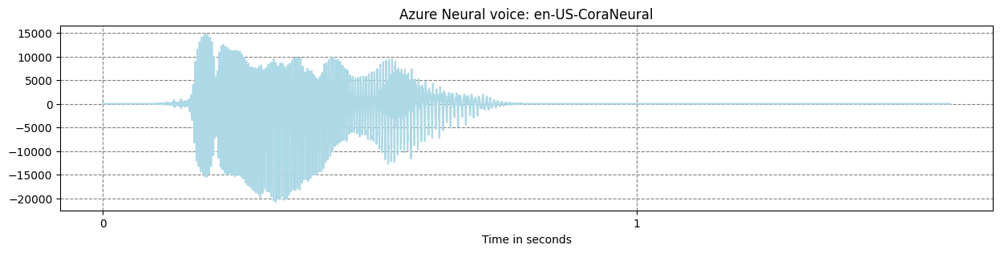

In [30]:
prompt = "Who are you?"

Audio(audio_playback(prompt, lang="EN", gender="F"))

Prompt: Who are you?

Response: I am an AI assistant designed to help you find information about fashion products. You can ask me questions about fashion trends, brands, styles, and more. Just let me know what you need help with!

11-Jul-2023 15:18:57 Powered by Azure AI


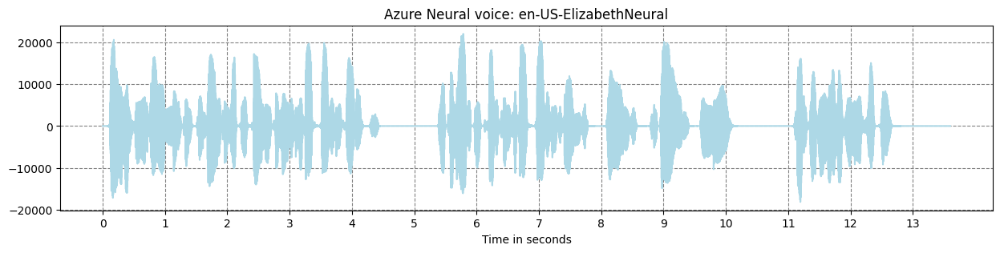

In [31]:
answer = azure_openai_chat(prompt)
Audio(audio_playback(answer, lang="EN", gender="F"))

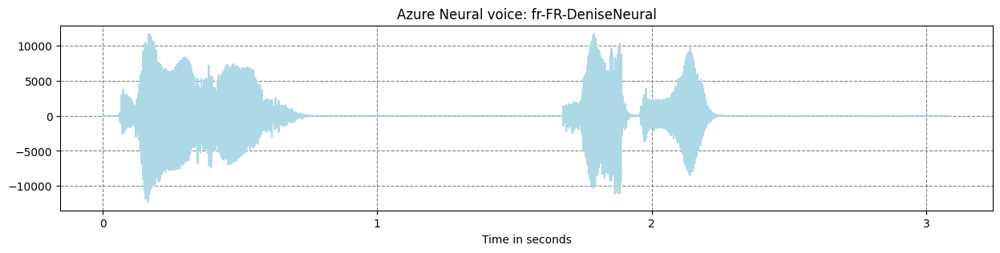

In [32]:
prompt = "Bonjour. Qui êtes-vous?"

Audio(audio_playback(prompt, lang="FR", gender="F"))

Prompt: 

Bonjour. Qui êtes-vous?

Response: 

Bonjour ! Je suis une assistante AI conçue pour aider les gens à trouver des informations sur les produits de mode. Comment puis-je vous aider aujourd'hui ?

11-Jul-2023 15:19:22 Powered by Azure AI


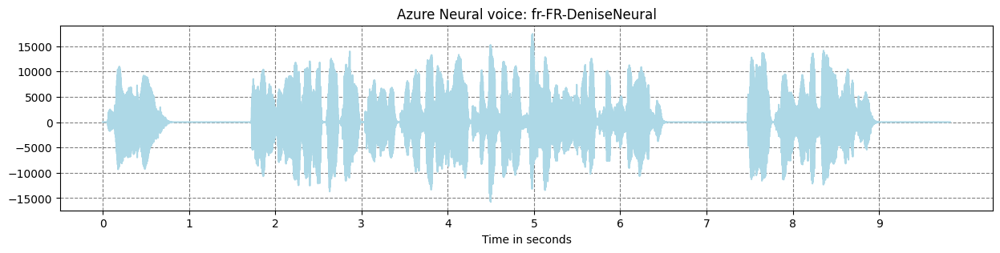

In [33]:
answer = azure_openai_chat(prompt, lang="French")
Audio(audio_playback(answer, lang="FR", gender="F"))

In [34]:
prompt = "I want to spend one week of vacation in Seattle in December."

answer = azure_openai_chat(prompt)

Prompt: I want to spend one week of vacation in Seattle in December.

Response: That sounds like a great plan! Is there anything specific you are looking to do in Seattle during your vacation? Perhaps any particular fashion-related events or activities?

11-Jul-2023 15:19:33 Powered by Azure AI


In [35]:
prompt = "Show me some good places in Seattle"

answer = azure_openai_chat(prompt)

Prompt: Show me some good places in Seattle

Response: Sure! Here are some popular places to check out in Seattle:

1. Pike Place Market: This historic market is a popular tourist destination and a great place to find fresh produce, seafood, and unique artisanal products.

2. Space Needle: The Space Needle is one of the most iconic landmarks in Seattle and offers breathtaking views of the city from its observation deck.

3. Seattle Art Museum: This museum features a diverse collection of art from around the world, including contemporary, African, and Native American art.

4. Chihuly Garden and Glass: This museum showcases the stunning glass art of artist Dale Chihuly and features a beautiful outdoor garden.

5. Pioneer Square: This neighborhood is known for its charming historic buildings, art galleries, and trendy restaurants and bars.

6. Museum of Pop Culture: This museum is dedicated to all things pop culture, including music, movies, video games, and more.

7. Seattle Central Libr

In [36]:
prompt = "What is the usual weather in Seattle in December?"

answer = azure_openai_chat(prompt)

Prompt: What is the usual weather in Seattle in December?

Response: Seattle has a cool and wet climate, with December typically being one of the wettest and coldest months of the year. The average temperature in Seattle during December is around 47°F (8°C), with highs around 49°F (9°C) and lows around 44°F (7°C). It's also common for Seattle to experience rainfall during this time of year.

11-Jul-2023 15:19:53 Powered by Azure AI


In [37]:
prompt = "What are the 5 biggest companies in Seattle?"

answer = azure_openai_chat(prompt)

Prompt: What are the 5 biggest companies in Seattle?

Response: The five biggest companies in Seattle are Amazon, Boeing, Microsoft, Starbucks, and Nordstrom.

11-Jul-2023 15:19:56 Powered by Azure AI


In [38]:
prompt = "What are the address of the Microsoft company in Seattle?"

answer = azure_openai_chat(prompt)

Prompt: What are the address of the Microsoft company in Seattle?

Response: The Microsoft Corporation headquarters is located at One Microsoft Way, Redmond, Washington, USA. It is about 16 miles east of Seattle.

11-Jul-2023 15:20:00 Powered by Azure AI


In [39]:
prompt = "I want a numbered list of the clothes I need for one week in Seattle in December.\
Just need the products type."

mylist = azure_openai_chat(prompt)

Prompt: I want a numbered list of the clothes I need for one week in Seattle in December.Just need the products type.

Response: Sure, here's a list of clothes you may need for a week in Seattle in December:

1. Warm winter coat
2. Waterproof boots
3. Scarf
4. Gloves
5. Hat
6. Sweaters
7. Long-sleeved shirts
8. Jeans or warm pants
9. Thermal underwear
10. Socks
11. Umbrella or rain jacket
12. Fleece jacket or vest
13. Flannel shirt
14. Pajamas or loungewear

Keep in mind that the weather in Seattle can be unpredictable, so it's a good idea to pack layers and be prepared for rain and cold temperatures.

11-Jul-2023 15:20:10 Powered by Azure AI


In [40]:
clothes_list = get_list()

Item 1: Warm winter coat.
Item 2: Waterproof boots.
Item 3: Scarf.
Item 4: Gloves.
Item 5: Hat.
Item 6: Sweaters.
Item 7: Long-sleeved shirts.
Item 8: Jeans or warm pants.
Item 9: Thermal underwear.
Item 10: Socks.
Item 11: Umbrella or rain jacket.
Item 12: Fleece jacket or vest.
Item 13: Flannel shirt.
Item 14: Pajamas or loungewear.


Item 1: Warm winter coat

Finding images using prompt = Warm winter coat 



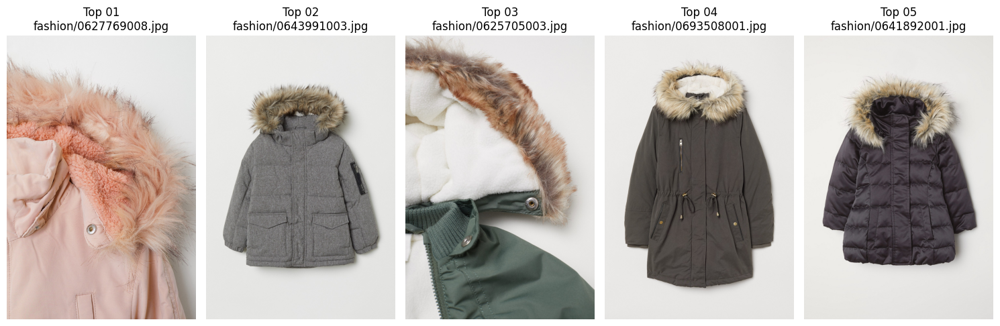

Item 2: Waterproof boots

Finding images using prompt = Waterproof boots 



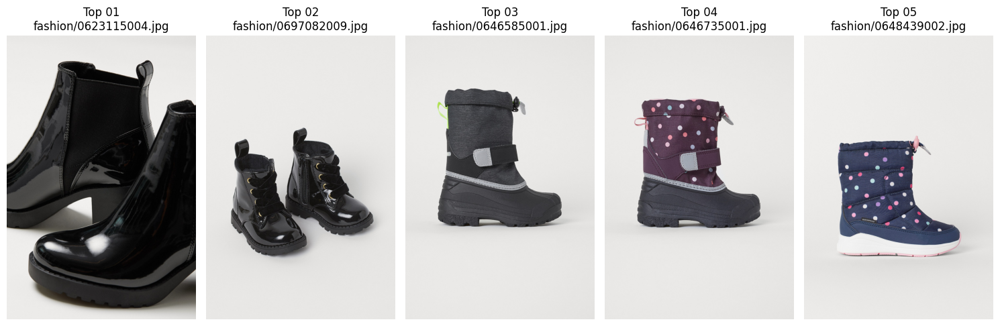

Item 3: Scarf

Finding images using prompt = Scarf 



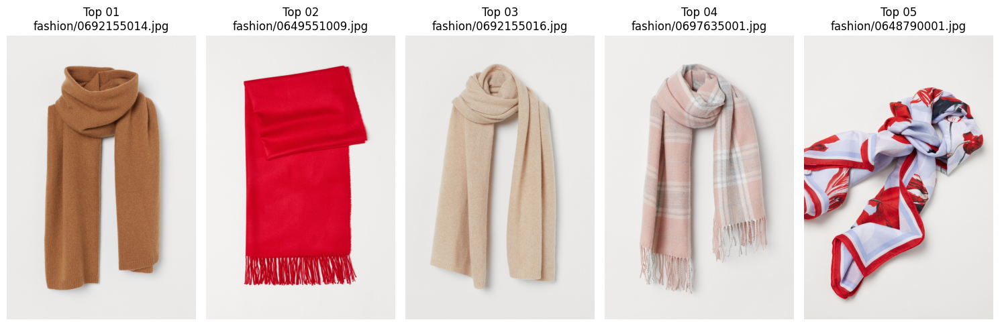

Item 4: Gloves

Finding images using prompt = Gloves 



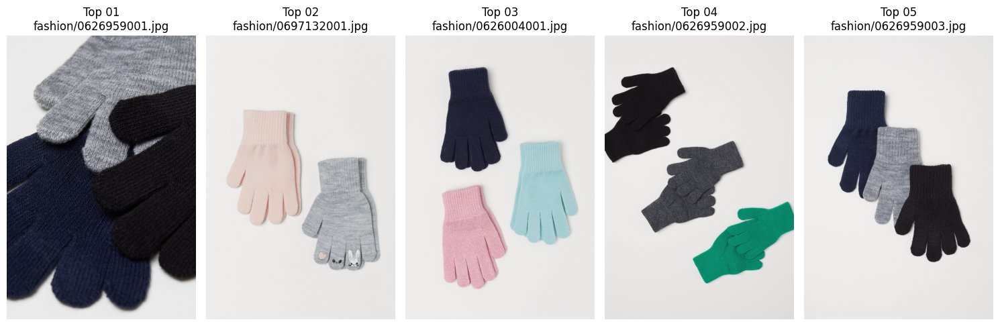

Item 5: Hat

Finding images using prompt = Hat 



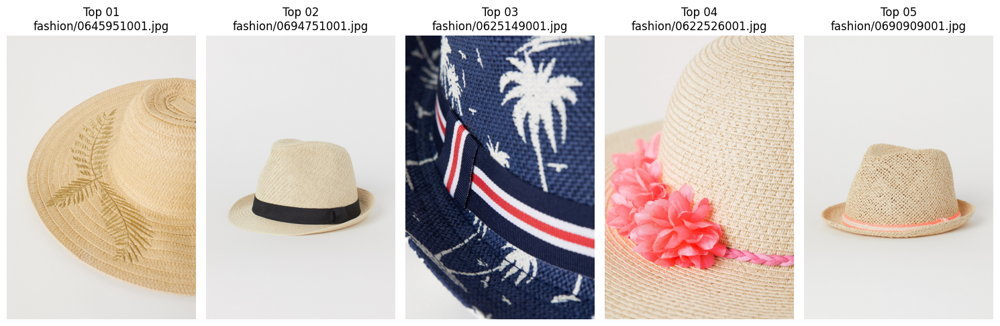

Item 6: Sweaters

Finding images using prompt = Sweaters 



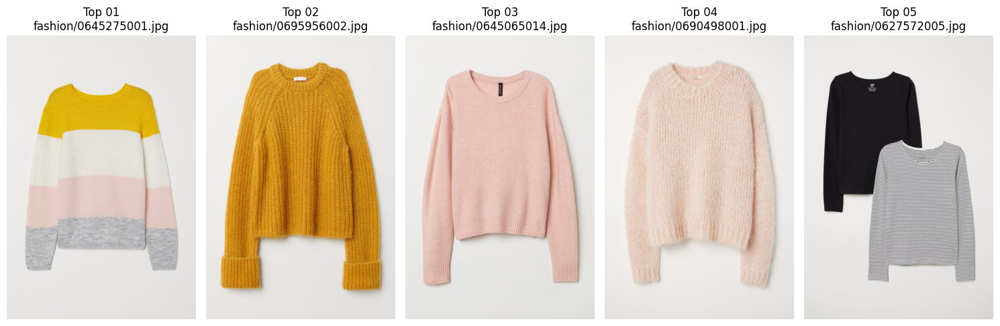

Item 7: Long-sleeved shirts

Finding images using prompt = Long-sleeved shirts 



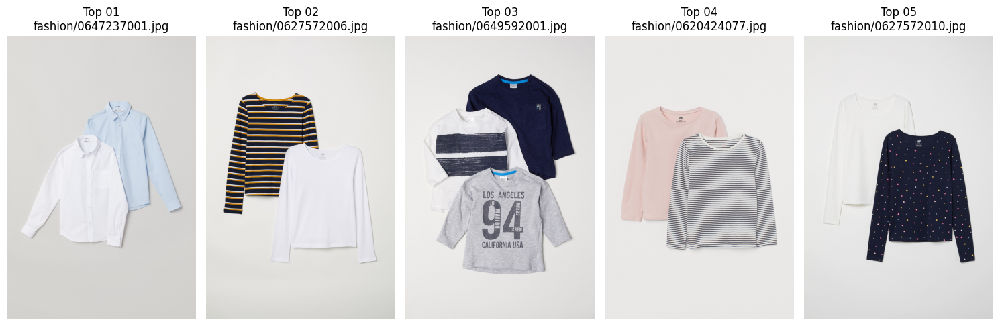

Item 8: Jeans or warm pants

Finding images using prompt = Jeans or warm pants 



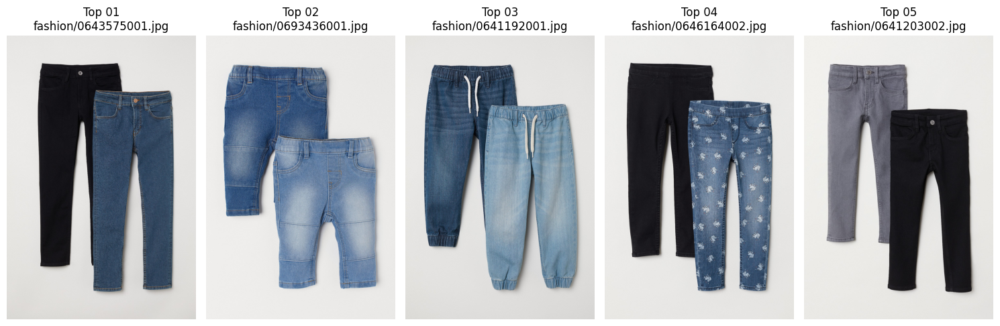

Item 9: Thermal underwear

Finding images using prompt = Thermal underwear 



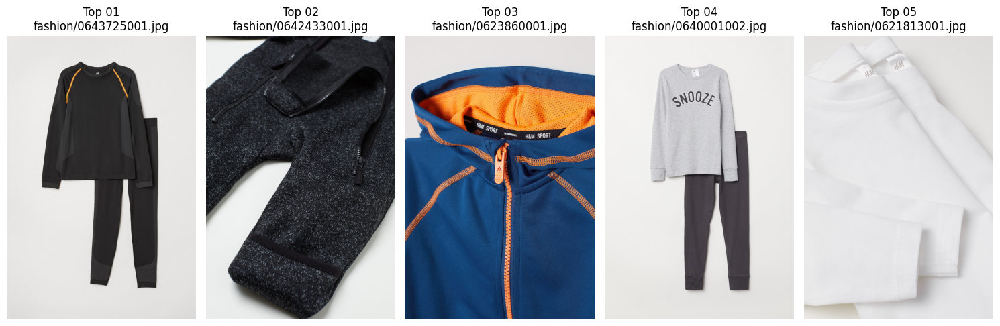

Item 10: Socks

Finding images using prompt = Socks 



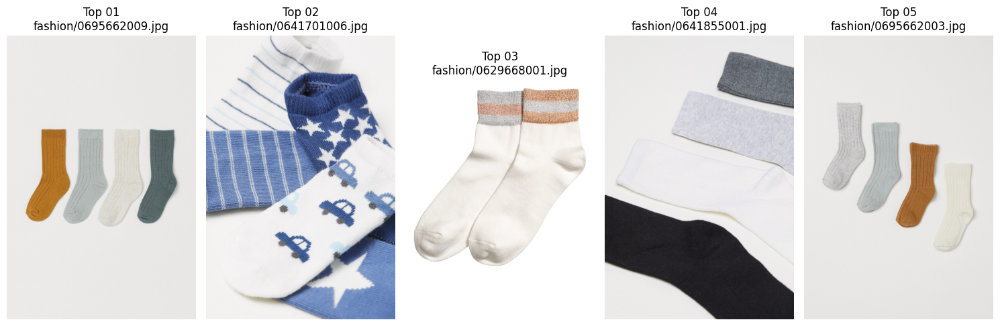

Item 11: Umbrella or rain jacket

Finding images using prompt = Umbrella or rain jacket 



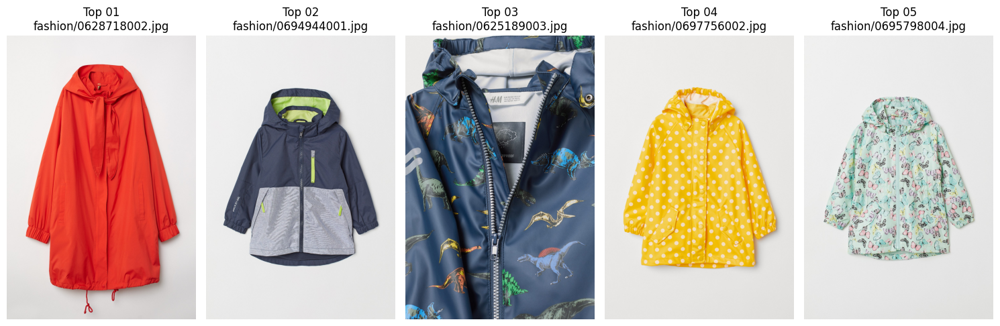

Item 12: Fleece jacket or vest

Finding images using prompt = Fleece jacket or vest 



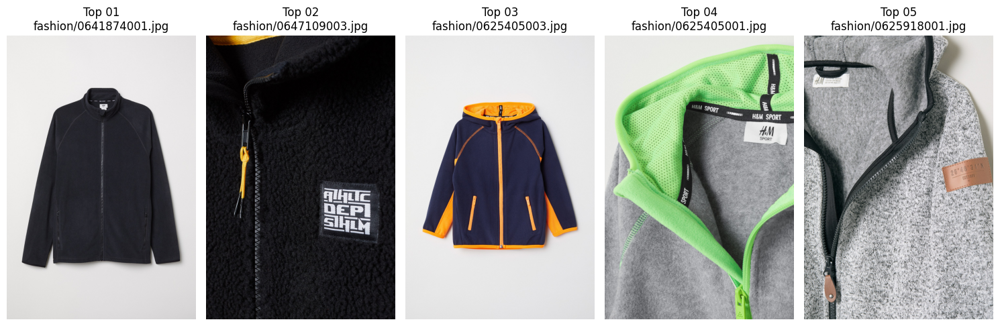

Item 13: Flannel shirt

Finding images using prompt = Flannel shirt 



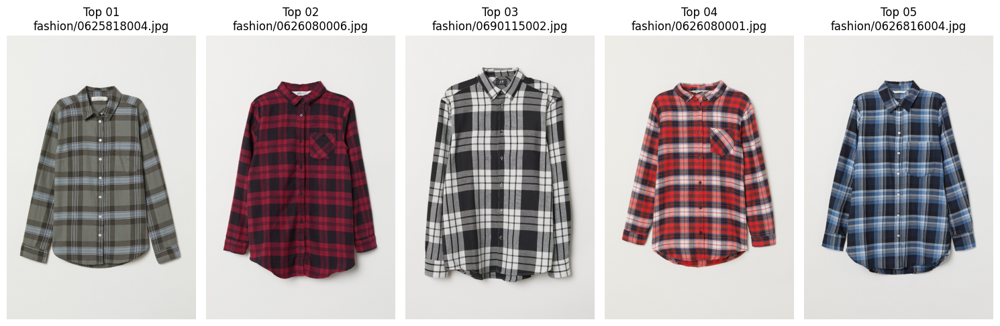

Item 14: Pajamas or loungewear

Finding images using prompt = Pajamas or loungewear 



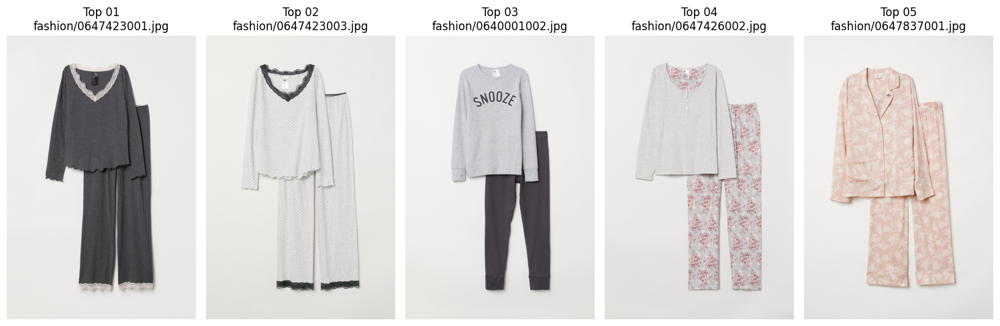


11-Jul-2023 15:20:51  End of search - Powered by Azure AI


In [41]:
visual_search()

In [42]:
prompt = "I want to spend one week of vacation in Monaco in July."

answer = azure_openai_chat(prompt)

Prompt: I want to spend one week of vacation in Monaco in July.

Response: That sounds like a great plan! Are you looking for information on fashion-related activities or shopping in Monaco during your trip?

11-Jul-2023 15:20:56 Powered by Azure AI


In [43]:
prompt = "I want to spend one week of vacation in Monaco in July. What are the best places to visit?"

answer = azure_openai_chat(prompt)

Prompt: I want to spend one week of vacation in Monaco in July. What are the best places to visit?

Response: Monaco is a beautiful destination with many places to visit. Here are some of the best places to visit during your vacation in July:

1. Monte Carlo Casino: This iconic casino is a must-visit for anyone visiting Monaco. You can try your luck at the slot machines or enjoy a game of roulette or blackjack.

2. Prince's Palace of Monaco: This palace is the official residence of the Prince of Monaco and offers stunning views of the Mediterranean Sea.

3. Oceanographic Museum: This museum showcases a vast collection of marine life and is perfect for families with kids.

4. The Rock of Monaco: This is the oldest part of Monaco and offers stunning views of the city. You can also visit the Saint Nicholas Cathedral and the Oceanographic Museum.

5. Monaco Grand Prix Circuit: If you're a Formula 1 fan, you can visit the famous Grand Prix Circuit and learn about the history of the race.

6

In [44]:
prompt = "I want a numbered list of the clothes I need for one week in Monaco this July.\
Just need the products names."

mylist = azure_openai_chat(prompt)

Prompt: I want a numbered list of the clothes I need for one week in Monaco this July.Just need the products names.

Response: Sure, here is a list of the clothing items you may need for a week in Monaco in July:

1. Lightweight tops and t-shirts
2. Shorts or skirts
3. Sundresses or maxi dresses
4. Swimwear
5. Sunglasses
6. Comfortable walking shoes
7. Sandals or flip flops for the beach
8. A light jacket or sweater for cooler evenings
9. A hat to protect you from the sun
10. Elegant evening wear for dinner or events.

11-Jul-2023 15:21:18 Powered by Azure AI


In [45]:
clothes_list = get_list()

Item 1: Lightweight tops and t-shirts.
Item 2: Shorts or skirts.
Item 3: Sundresses or maxi dresses.
Item 4: Swimwear.
Item 5: Sunglasses.
Item 6: Comfortable walking shoes.
Item 7: Sandals or flip flops for the beach.
Item 8: A light jacket or sweater for cooler evenings.
Item 9: A hat to protect you from the sun.
Item 10: Elegant evening wear for dinner or events..


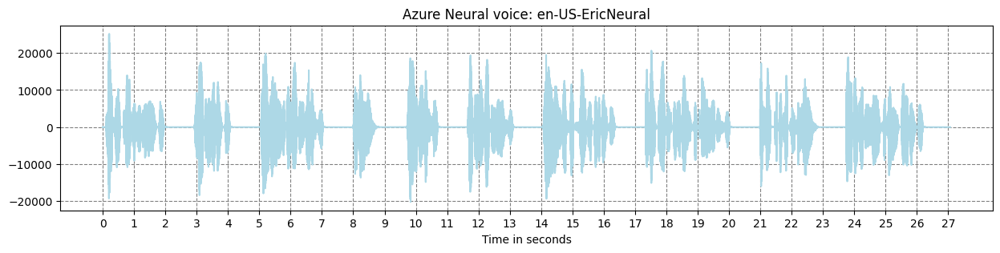

In [46]:
Audio(audio_playback(clothes_list, lang="EN"))

Item 1: Lightweight tops and t-shirts

Finding images using prompt = Lightweight tops and t-shirts 



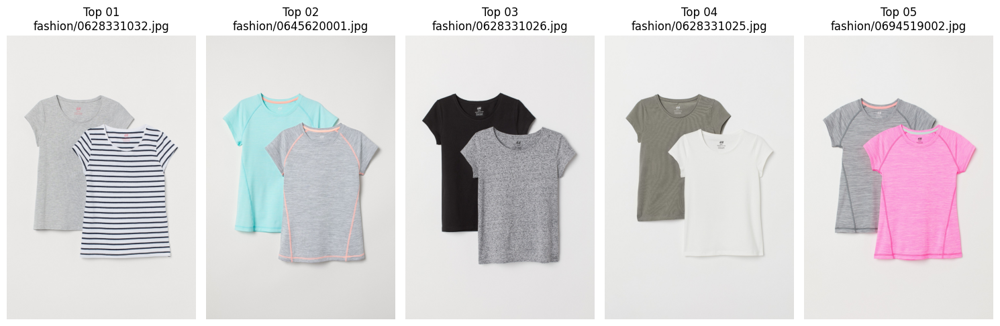

Item 2: Shorts or skirts

Finding images using prompt = Shorts or skirts 



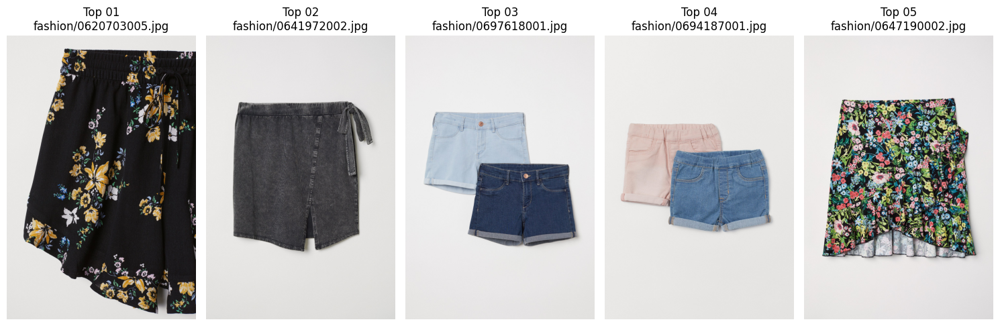

Item 3: Sundresses or maxi dresses

Finding images using prompt = Sundresses or maxi dresses 



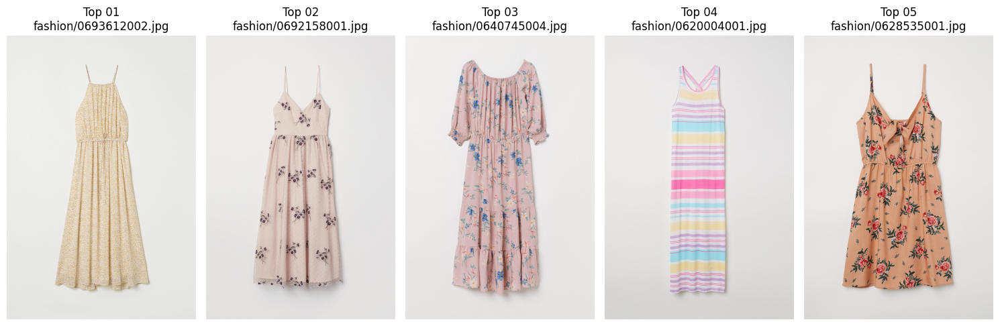

Item 4: Swimwear

Finding images using prompt = Swimwear 



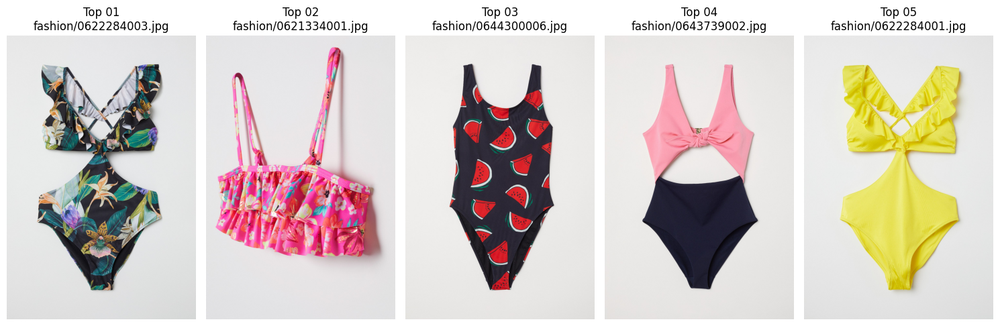

Item 5: Sunglasses

Finding images using prompt = Sunglasses 



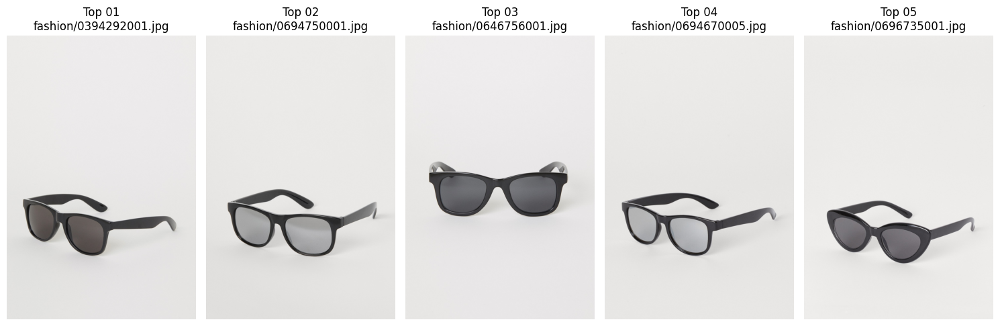

Item 6: Comfortable walking shoes

Finding images using prompt = Comfortable walking shoes 



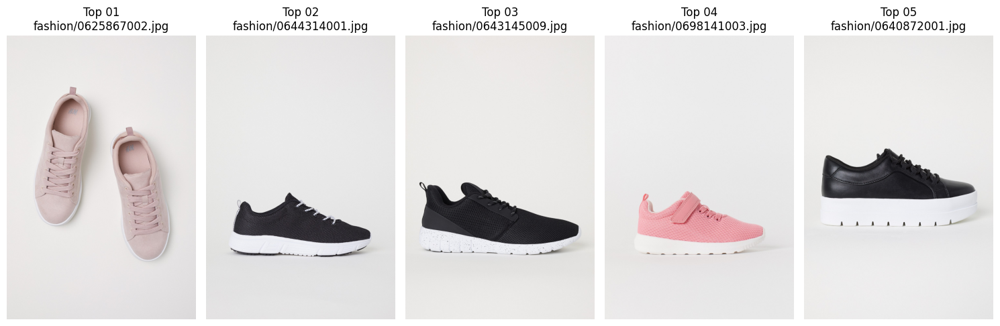

Item 7: Sandals or flip flops for the beach

Finding images using prompt = Sandals or flip flops for the beach 



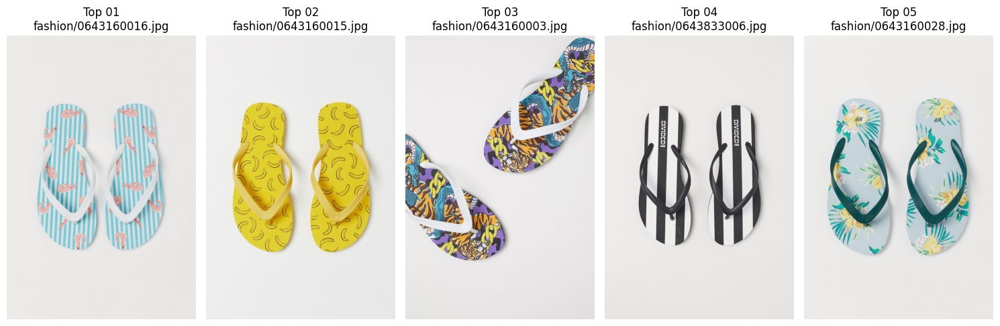

Item 8: A light jacket or sweater for cooler evenings

Finding images using prompt = A light jacket or sweater for cooler evenings 



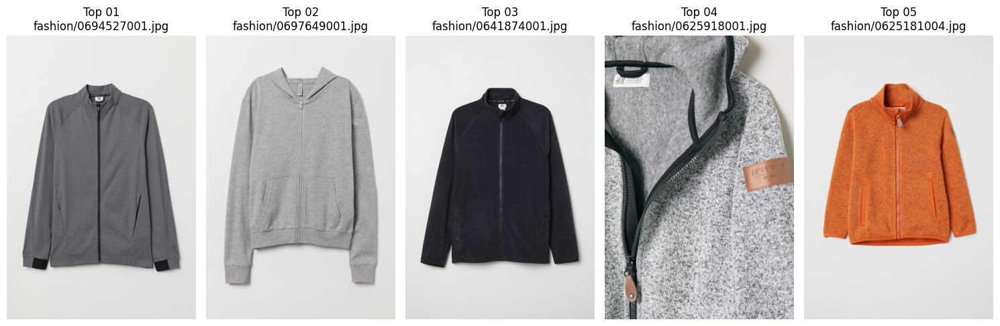

Item 9: A hat to protect you from the sun

Finding images using prompt = A hat to protect you from the sun 



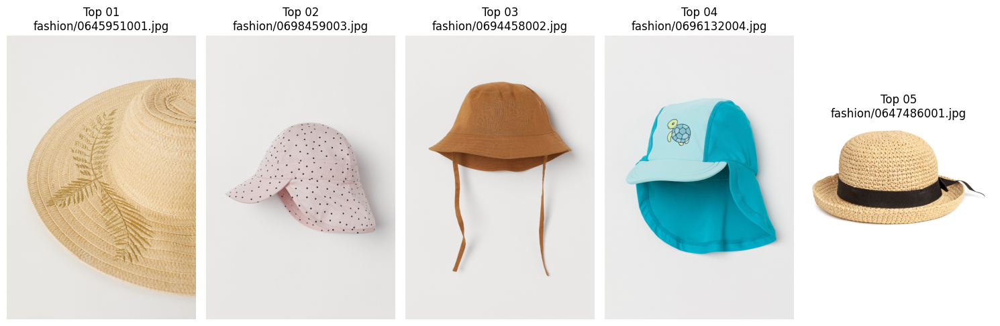

Item 10: Elegant evening wear for dinner or events.

Finding images using prompt = Elegant evening wear for dinner or events. 



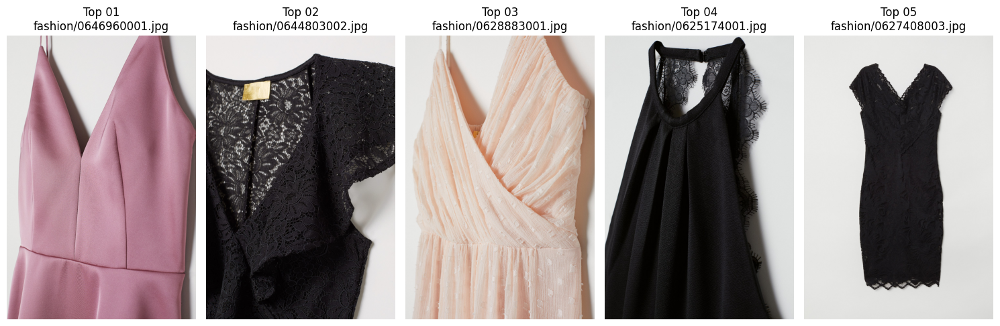


11-Jul-2023 15:21:49  End of search - Powered by Azure AI


In [47]:
visual_search()